In [2]:
# =============================
# Library Imports
# =============================

import h5py
import matplotlib.pyplot as plt
import numpy as np
import astropy.io.fits as fits
from scipy.ndimage import rotate
from matplotlib.colors import LogNorm
from matplotlib.patches import Rectangle

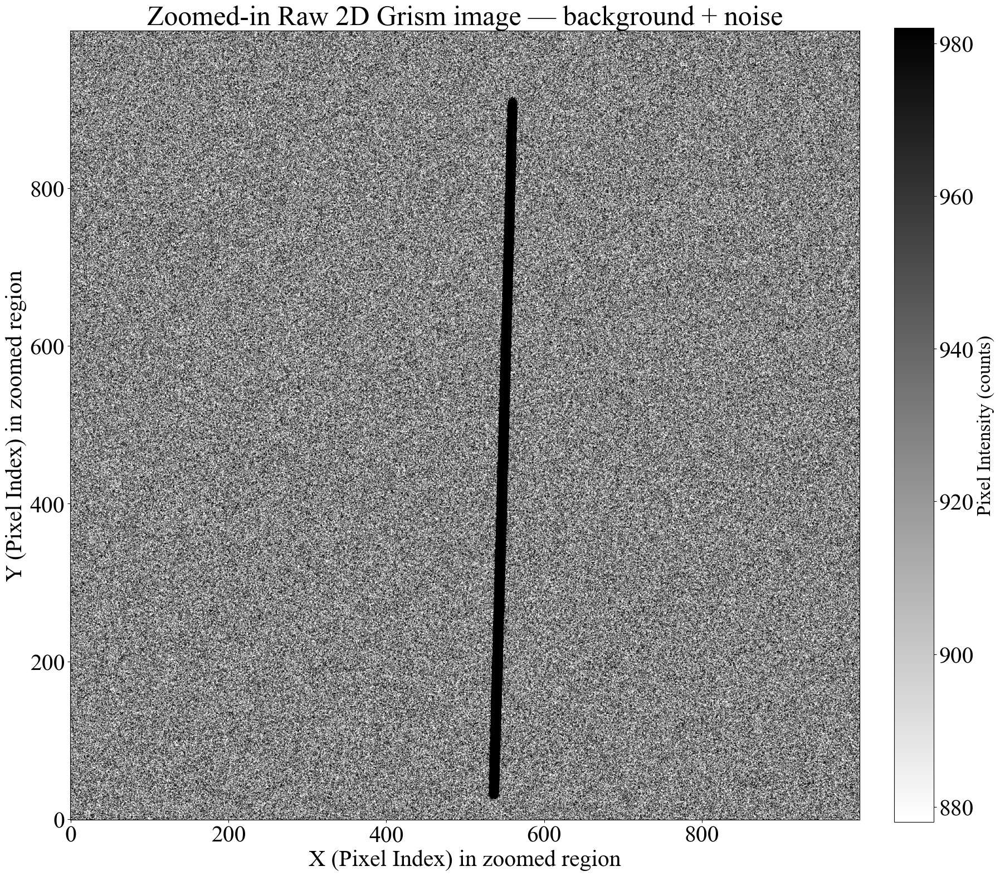

In [3]:
# Step 1: File path for the 2D grism image
grism_file = "/Users/msingha/Downloads/Grism extraction/QSO_grism.fits"

# Step 2: Load the 2D spectrum data from the FITS file
counts_noisy_1160s = fits.getdata(grism_file)

# Step 3: Define region of interest (ROI) safely for zoom-in
x_start, x_end = 1500, 2500
y_start, y_end = 1500, 2500
x_end = min(x_end, counts_noisy_1160s.shape[1])  # keep within image bounds
y_end = min(y_end, counts_noisy_1160s.shape[0])  # keep within image bounds
zoomed_counts = counts_noisy_1160s[y_start:y_end, x_start:x_end]

# Step 4: Set global plot style
plt.rcParams.update({'font.size': 30, 'font.family': 'Times New Roman'})

# Plot 1: Linear Scale (shows strong features like emission lines)
fig1 = plt.figure(figsize=(20, 20))
plt.imshow(
    zoomed_counts,
    origin='lower',
    cmap='binary',
    vmin=np.percentile(zoomed_counts, 5),   # lower contrast bound
    vmax=np.percentile(zoomed_counts, 95)   # upper contrast bound
)
cbar1 = plt.colorbar(fraction=0.046, pad=0.04)
cbar1.set_label("Pixel Intensity (counts)", fontsize=25)
plt.title("Zoomed-in Raw 2D Grism image — background + noise")
plt.xlabel("X (Pixel Index) in zoomed region")
plt.ylabel("Y (Pixel Index) in zoomed region")
plt.show()


### Grism Image Workflow

- Step 1: File path  
  The FITS file (`QSO_grism.fits`) contains the 2D dispersed spectrum image from the grism observation.  

- Step 2: Load data  
  The image data is read into a NumPy array using `astropy.io.fits.getdata()`. Each pixel holds counts recorded during the exposure.  

- Step 3: Region of interest (ROI)  
  A rectangular cutout (1500–2500 pixels in both X and Y) is extracted for zoom-in.  
  The bounds are checked against the image size with `min(...)` to avoid index errors.  

- Step 4: Global plot style  
  Font size and family are set globally for consistent figure aesthetics.  

- Plot 1: Linear scale visualization  
  The zoomed ROI is plotted with grayscale (`binary` colormap).  
  Pixel intensities are scaled to the 5th–95th percentile range for contrast.  
  The colorbar shows pixel intensity (counts). This view highlights bright features such as emission lines while still showing background and noise.  


In [4]:
# =============================
# Spectrum Setup Parameters
# =============================

# Step 1: Exposure time (s)
exposure_time = 1160  

# Step 2: Dispersion (Å/pixel)
dispersion_angstrom = 10.52  # On orbit data with come up with calibrated maesauyement of dispersion. 
#In this tutorial, we are giving you a simple linear dispersion whgich is sufficient for the simulation

# Step 3: Convert dispersion to μm/pixel
dispersion_micron = dispersion_angstrom * 1e-4  

# Step 4: Starting wavelength (μm)
wave_start = 0.987 # On orbit data with come up with calibrated maesauyement of starting waveleng. 
#In this tutorial, we are giving you a simple linear dispersion whgich is sufficient for the simulation



##### Spectrum Setup Explanations

- Step 1: Exposure time  
  Duration of image data collection in seconds. Longer exposures collect more photons and improve signal-to-noise.  

- Step 2: Dispersion in Å/pixel  
  The change in wavelength per pixel on the detector. Here, each pixel corresponds to 10.52 Å.  

- Step 3: Conversion to μm/pixel  
  For infrared work, wavelengths are often expressed in microns.  
  Since 1 Å = 1e-4 μm, the dispersion is converted accordingly.  

- Step 4: Starting wavelength  
  The wavelength at the first pixel of the spectrum.  
  Although the grism nominally starts at 1.0 μm, a direct pixel-to-pixel comparison shows that the de-tilted trace begins slightly earlier at 0.987 μm.  


Grism image dimensions after de-tilting: 4088 x 4088


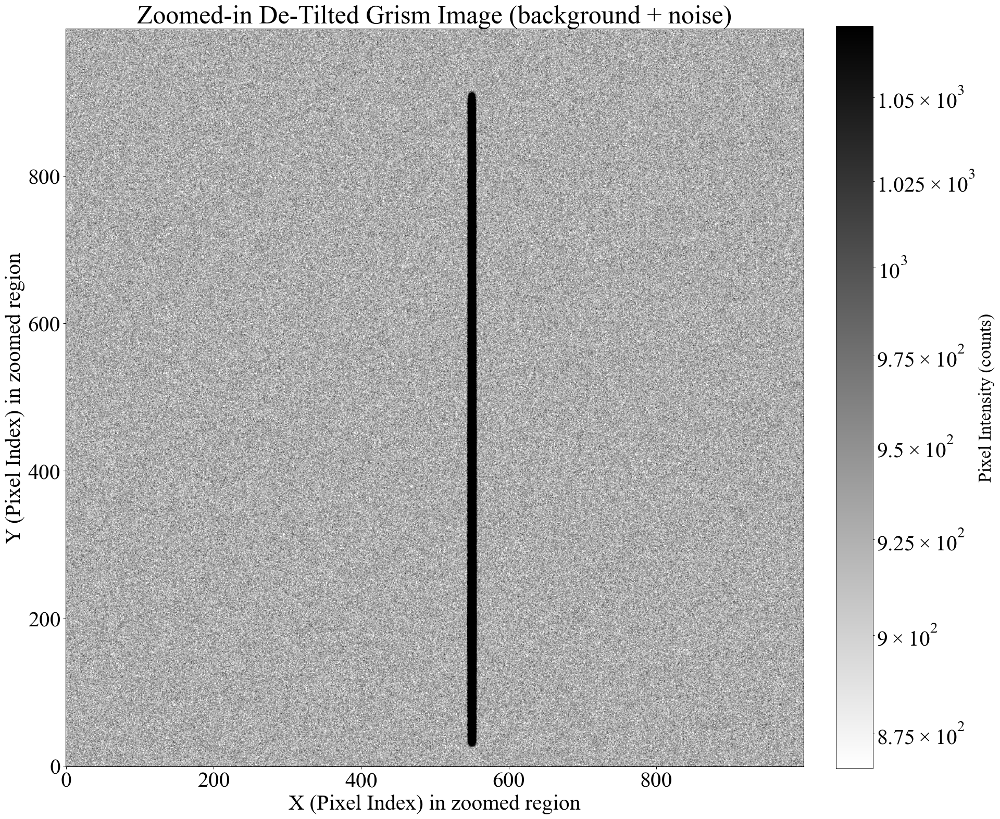

In [5]:
# =============================
# Grism Image De-Tilting and Log-Scale Plot
# =============================

# Step 1: Load the 2D grism image (with noise and background)
counts_noisy_1160s = fits.getdata(grism_file)

# Step 2: Define the rotation angle (degrees counterclockwise)
rotation_angle = -1.562  # On orbit data with come up with calibrated maesauyement of tilt angle. 
#In this tutorial, we are giving you a simple linear dispersion wgich is sufficient for the simulation


# Step 3: Rotate image with cubic interpolation, reflecting at edges
rotated_data = rotate(
    counts_noisy_1160s,
    rotation_angle,
    reshape=True,
    order=3,
    mode='reflect'
)

# Step 4: Crop rotated image back to original 4088×4088 pixels
crop_start = (rotated_data.shape[0] - 4088) // 2
crop_end = crop_start + 4088
big_data = rotated_data[crop_start:crop_end, crop_start:crop_end]

# Step 5: Confirm the shape
grism_file_shape_y, grism_file_shape_x = big_data.shape
print(f"Grism image dimensions after de-tilting: {grism_file_shape_y} x {grism_file_shape_x}")

# Step 6: Define ROI bounds
x_start, x_end = 1500, 2500
y_start, y_end = 1500, 2500
x_end = min(x_end, big_data.shape[1])
y_end = min(y_end, big_data.shape[0])

# Step 7: Extract zoomed-in ROI
zoomed_big_data = big_data[y_start:y_end, x_start:x_end]

# Step 8: Set up figure style
fig = plt.figure(figsize=(20, 20))
plt.rcParams.update({'font.size': 30, 'font.family': 'Times New Roman'})

# Step 9: Plot ROI in log scale (reveals faint structures + noise)
plt.imshow(
    zoomed_big_data,
    origin='lower',
    cmap='binary',
    norm=LogNorm(
        vmin=np.percentile(zoomed_big_data[zoomed_big_data > 0], 1),  # avoid zeros
        vmax=np.percentile(zoomed_big_data, 99)
    )
)

# Step 10: Add colorbar
cbar = plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_label("Pixel Intensity (counts)", fontsize=25)

# Step 11: Title and axis labels
plt.title("Zoomed-in De-Tilted Grism Image (background + noise)")
plt.xlabel("X (Pixel Index) in zoomed region")
plt.ylabel("Y (Pixel Index) in zoomed region")

# Step 12: Show the plot
plt.show()


### De-Tilting and Log-Scale Visualization

- Step 1: Load image  
  The noisy grism image is loaded from the FITS file. Each pixel stores photon counts.  

- Step 2: Rotation angle  
  The grism spectrum is tilted by 1.562°. A counterclockwise rotation corrects this.  

- Step 3: Rotate with interpolation  
  The image is rotated using cubic interpolation (`order=3`) for smoothness.  
  The `reflect` mode handles edge pixels by mirroring data.  

- Step 4: Crop back to 4088×4088  
  Rotation increases image size. The result is cropped back to the original detector dimensions.  

- Step 5: Confirm dimensions  
  Ensures the final de-tilted frame matches the expected size.  

- Step 6–7: ROI selection  
  A subregion (1500–2500 in both axes) is extracted for detailed inspection.  
  Bounds are checked against image shape to avoid indexing errors.  

- Step 8: Plot style  
  Global font settings are applied for clarity in publication-style figures.  

- Step 9: Log-scale plotting  
  Logarithmic scaling (`LogNorm`) makes faint background structures visible alongside bright emission features.  
  The lower bound excludes zeros to avoid log artifacts.  

- Step 10–12: Annotations  
  A colorbar shows counts per pixel. Title and axis labels describe the plotted region.  


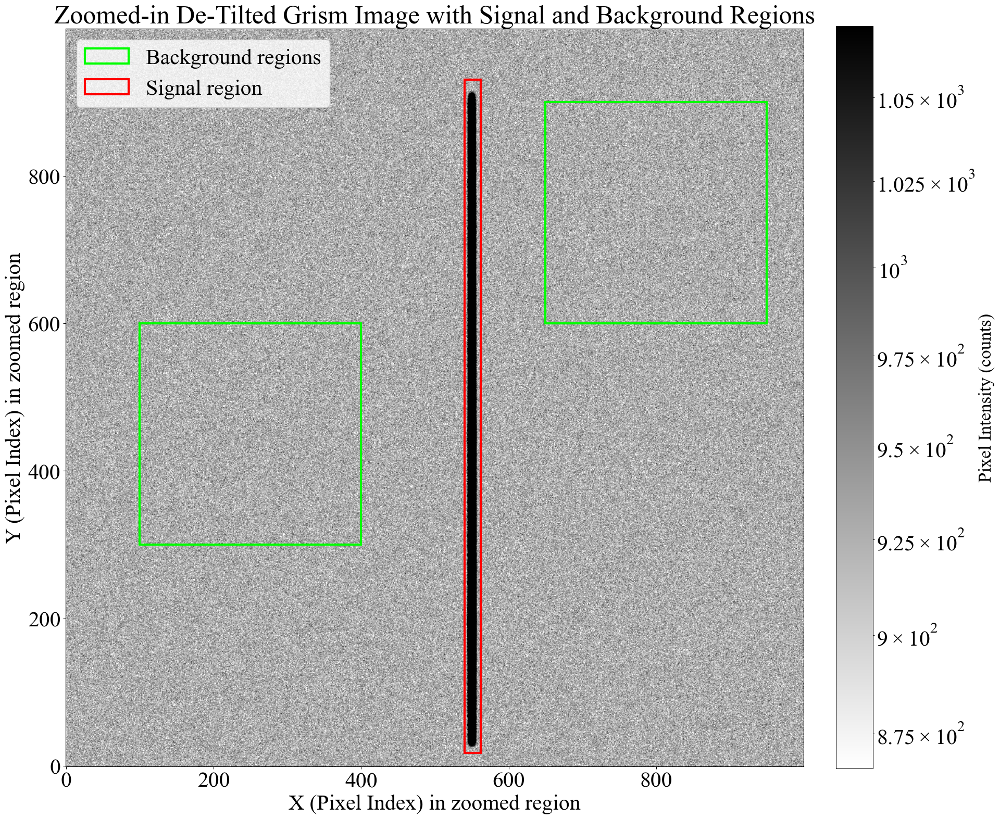

In [6]:
# =============================
# Signal and Background Region Extraction + Overlay
# =============================

# Step 1: Extract image chunks (verification / further analysis)
background_chunk_1 = big_data[1800:2100, 1600:1900]  # shape: 300×300
background_chunk_2 = big_data[2100:2400, 2150:2450]  # shape: 300×300
signal_chunk       = big_data[1518:2430, 2040:2062]  # shape: 912×22

# Step 2: Define ROI bounds (zoom-in window)
x_start, x_end = 1500, 2500
y_start, y_end = 1500, 2500
x_end = min(x_end, big_data.shape[1])
y_end = min(y_end, big_data.shape[0])

# Step 3: Extract zoomed-in data
zoomed_big_data = big_data[y_start:y_end, x_start:x_end]

# Step 4: Set up figure
fig, ax = plt.subplots(figsize=(20, 20))
plt.rcParams.update({'font.size': 30, 'font.family': 'Times New Roman'})

# Step 5: Plot zoomed-in image with log normalization
img = ax.imshow(
    zoomed_big_data,
    origin='lower',
    cmap='binary',
    norm=LogNorm(
        vmin=np.percentile(zoomed_big_data[zoomed_big_data > 0], 1),
        vmax=np.percentile(zoomed_big_data, 99)
    )
)

# Step 6: Add colorbar
cbar = plt.colorbar(img, ax=ax, fraction=0.046, pad=0.04)
cbar.set_label("Pixel Intensity (counts)", fontsize=25)

# Step 7: Overlay background regions (lime rectangles)
bg_rects = []
bg_boxes = [(1600, 1800), (2150, 2100)]  # (x, y) anchor positions
for x0, y0 in bg_boxes:
    if x_start <= x0 < x_end and y_start <= y0 < y_end:
        rect = Rectangle(
            (x0 - x_start, y0 - y_start), 300, 300,
            linewidth=3,
            edgecolor='lime',
            facecolor='none'
        )
        ax.add_patch(rect)
        bg_rects.append(rect)

# Step 8: Overlay signal region (red rectangle)
signal_rect = None
signal_x, signal_y = 2040, 1518
if x_start <= signal_x < x_end and y_start <= signal_y < y_end:
    signal_rect = Rectangle(
        (signal_x - x_start, signal_y - y_start), 22, 912,
        linewidth=3,
        edgecolor='r',
        facecolor='none'
    )
    ax.add_patch(signal_rect)

# Step 9: Add legend
legend_elements = []
if bg_rects:
    legend_elements.append(Rectangle((0, 0), 1, 1, edgecolor='lime', facecolor='none', linewidth=3, label='Background regions'))
if signal_rect:
    legend_elements.append(Rectangle((0, 0), 1, 1, edgecolor='r', facecolor='none', linewidth=3, label='Signal region'))
ax.legend(handles=legend_elements, loc='upper left', frameon=True)

# Step 10: Add title and axis labels
ax.set_title("Zoomed-in De-Tilted Grism Image with Signal and Background Regions")
ax.set_xlabel("X (Pixel Index) in zoomed region")
ax.set_ylabel("Y (Pixel Index) in zoomed region")

# Step 11: Show plot
plt.show()


### Signal and Background Region Extraction

- Step 1: Image chunks  
  Specific subarrays are extracted for inspection:  
  - Background chunks (300×300 each) sample noise and background levels.  
  - Signal chunk (912×22) captures the main spectral trace.  

- Step 2–3: ROI  
  The zoom-in region is defined as pixels [1500–2500] in both axes.  
  Bound checks ensure indices do not exceed image dimensions.  

- Step 4: Figure setup  
  Large figure size (20×20) with Times New Roman font for clarity.  

- Step 5: Log-scale image plot  
  The zoomed image is plotted with logarithmic normalization to reveal faint structures alongside strong signal.  

- Step 6: Colorbar  
  Displays pixel intensities (counts) for reference.  

- Step 7: Background overlays  
  Two lime green rectangles highlight background regions used for noise estimation.  

- Step 8: Signal overlay  
  A red rectangle marks the extracted spectral trace region.  

- Step 9: Legend  
  A legend explains the overlay colors: lime for background, red for signal.  

- Step 10–11: Annotations  
  Title and axis labels provide context for the zoomed-in detector region.  


Estimated Median Background for 1160s in counts: 927.8453369140625
Cropped trace shape: ny=922, nx=26


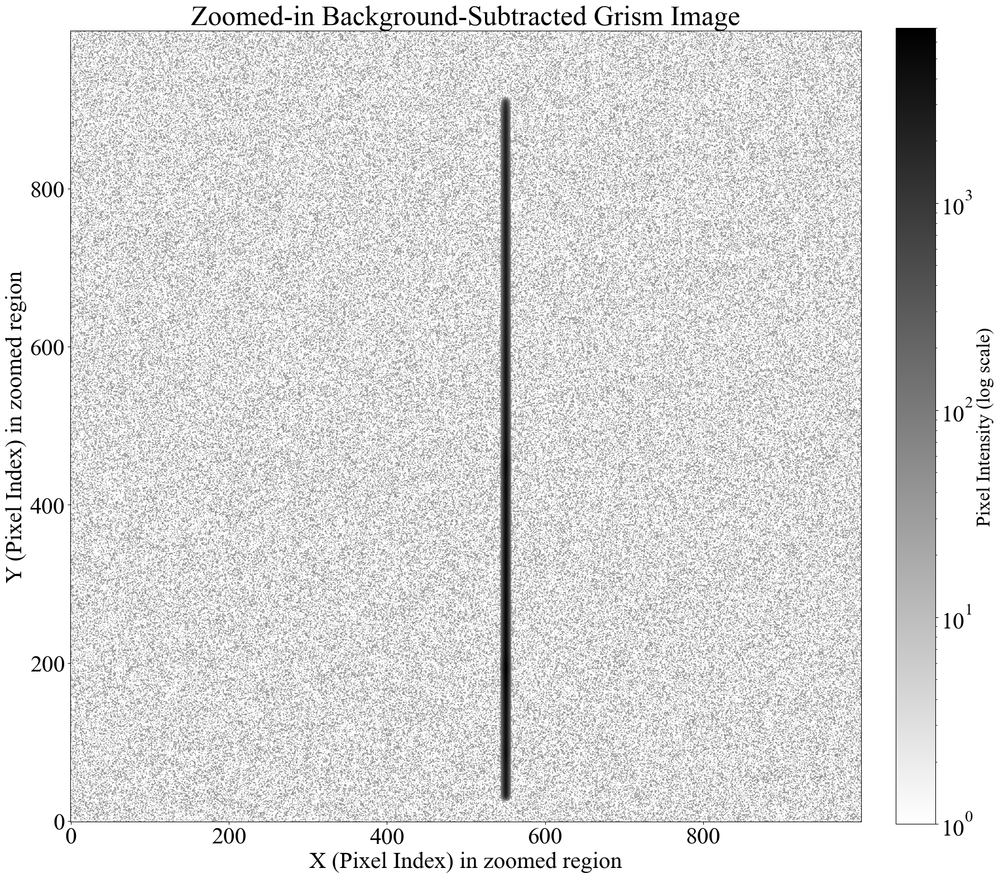

In [11]:
# =============================
# Background Estimation, Subtraction, and Zoomed Visualization
# =============================

# Step 1: Estimate background from signal-free chunks
# (avoid the known signal window: y=1518–2440, x=2040–2066)
median_background_1 = np.nanmedian(background_chunk_1)
median_background_2 = np.nanmedian(background_chunk_2)
median_background = 0.5 * (median_background_1 + median_background_2)
print(f"Estimated Median Background for 1160s in counts: {median_background}")

# Step 2: Build a constant background frame (same size as image)
background = np.full((big_data.shape[0], big_data.shape[1]), median_background)

# Step 3: Subtract background from the de-tilted image
background_subtracted_big_data = big_data - background
ny, nx = data.shape
print(f"Cropped trace shape: ny={ny}, nx={nx}")



# Step 4: Focus only on the known spectral trace region
# (crop to the signal window for any downstream analysis)
data = background_subtracted_big_data[1518:2440, 2040:2066]

# Step 5: Define ROI bounds for a zoomed view (publication-friendly panel)
x_start, x_end = 1500, 2500
y_start, y_end = 1500, 2500
x_end = min(x_end, background_subtracted_big_data.shape[1])
y_end = min(y_end, background_subtracted_big_data.shape[0])

# Step 6: Extract zoomed ROI
zoomed_background_subtracted_big_data = background_subtracted_big_data[y_start:y_end, x_start:x_end]

# Step 7: Figure + global font
fig = plt.figure(figsize=(20, 20))
plt.rcParams.update({'font.size': 30, 'font.family': 'Times New Roman'})

# Step 8: Display zoomed image (log scale)
# vmin must be > 0 for LogNorm; choose fixed range suitable for this dataset
plt.imshow(
    zoomed_background_subtracted_big_data,
    origin='lower',
    cmap='binary',
    norm=LogNorm(vmin=1, vmax=7000)
)

# Step 9: Colorbar
cbar = plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_label("Pixel Intensity (log scale)", fontsize=25)

# Step 10: Titles and labels
plt.title("Zoomed-in Background-Subtracted Grism Image")
plt.xlabel("X (Pixel Index) in zoomed region")
plt.ylabel("Y (Pixel Index) in zoomed region")

# Step 11: Render
plt.show()


### Background subtraction and zoomed view

- Step 1: Background estimate  
  Compute median counts from two signal-free chunks near the trace but outside the known signal window (y=1518–2440, x=2040–2066). Using the median is robust to hot pixels and outliers.

- Step 2: Constant background frame  
  Create a full-frame array where each pixel equals the estimated median background. This models a spatially flat background.

- Step 3: Subtract background  
  Remove the constant background from the de-tilted image to isolate the source signal and reduce large-scale offsets.

- Step 4: Trace-only crop  
  Slice the background-subtracted frame to the known trace window for any downstream extraction or statistics.

- Step 5–6: ROI for visualization  
  Define and extract a larger, square zoom around the trace (1500–2500 in both axes) for a publication-friendly figure.

- Step 7–8: Log-scale display  
  Use logarithmic normalization (LogNorm) to show faint structure and residual background alongside bright pixels. vmin must be > 0.

- Step 9–11: Annotations  
  Add a labeled colorbar, descriptive title, and axis labels; render the figure.


##### BASIC Horne optimal extraction with a single fixed profile:

In [13]:
# --- Build a simple variance map with the SAME SHAPE as `data` ---
# Poisson on (background + positive signal) + read noise^2
GAIN_E_PER_CNT = 1.0   # adjust if your data are in counts not electrons
READ_NOISE = 5.0       # e- RMS / pixel
MIN_VAR = 1e-6

bg_e = median_background * GAIN_E_PER_CNT
sig_e = np.maximum(data, 0.0) * GAIN_E_PER_CNT
var = (bg_e + sig_e) + READ_NOISE**2
var = np.maximum(var, MIN_VAR)

profile = np.sum(np.clip(data, 0, None), axis=0)
profile = np.clip(profile, 0, None)
P = profile / profile.sum() if profile.sum() > 0 else np.ones(nx)/nx

F_opt = np.zeros(ny)
Var_opt = np.zeros(ny)

for j in range(ny):
    d = data[j, :]
    v = var[j, :]

    good = (v > 0) & np.isfinite(d) & np.isfinite(v)
    if not np.any(good):
        F_opt[j], Var_opt[j] = 0.0, np.inf
        continue

    P_row = P[good]
    d_row = d[good]
    v_row = v[good]

    num = np.sum(P_row * d_row / v_row)
    den = np.sum(P_row**2 / v_row)

    if den > 0:
        F_opt[j] = num / den
        Var_opt[j] = 1.0 / den
    else:
        F_opt[j], Var_opt[j] = 0.0, np.inf

sigma_opt = np.sqrt(np.maximum(Var_opt, 0.0))


## Basic Horne Optimal Extraction (with Fixed Profile)

This section implements the optimal extraction method described by Horne (1986).  
The goal is to extract a 1D spectrum with **maximum signal-to-noise** by weighting each pixel according to its expected spatial profile and variance.

---

### Building the Spatial Profile

- Collapse the 2D trace along the **dispersion direction** to obtain a high signal-to-noise average profile in the spatial direction.
- Negative pixel values are clipped to zero to avoid biasing the profile.
- Normalize the profile so that the sum over $x$ is unity:

$P(x) = \frac{\mathrm{profile}(x)}{\sum_x \mathrm{profile}(x)}$

- If the trace contains no signal (sum = 0), fall back to a uniform flat profile.

$P(x)$ represents the average way light is distributed across the cross-dispersion axis of the detector.

---

### Initialization

- Two arrays are prepared, both of length $n_y$ (the number of dispersion rows):
  - $F_{\mathrm{opt}}$: the optimally extracted flux as a function of row (wavelength).
  - $\mathrm{Var}_{\mathrm{opt}}$: the variance estimate for each flux value.

---

### Loop Over Dispersion Rows

For each row $j$ (corresponding to a wavelength bin):

1. Extract the row’s data $d(x)$ and variance $v(x)$.
2. Define a mask of **good pixels**: finite values with $v(x) > 0$.
3. If no good pixels exist, set $F_{\mathrm{opt}}(j) = 0$ and $\mathrm{Var}_{\mathrm{opt}}(j) = \infty$.

---

### Optimal Extraction Formula

For rows with valid pixels:

- Numerator:

$\mathrm{num}(j) = \sum_x \frac{P(x)\, d(x)}{v(x)}$

- Denominator:

$\mathrm{den}(j) = \sum_x \frac{P(x)^2}{v(x)}$

- Flux estimate:

$F_{\mathrm{opt}}(j) = \frac{\mathrm{num}(j)}{\mathrm{den}(j)}$

- Variance estimate:

$\mathrm{Var}_{\mathrm{opt}}(j) = \frac{1}{\mathrm{den}(j)}$

If $\mathrm{den}(j) = 0$, assign zero flux and infinite variance.

---

### Uncertainties

The 1-sigma uncertainty on the optimally extracted flux is:

$\sigma_{\mathrm{opt}}(j) = \sqrt{\max(\mathrm{Var}_{\mathrm{opt}}(j), 0)}$

This ensures numerical stability (no negative values inside the square root).

---

### Summary

- **Profile weighting**: pixels closer to the profile center (where $P(x)$ is high) contribute more.  
- **Noise weighting**: pixels with higher variance contribute less.  
- **Advantage**: compared to simple summation, this method boosts the effective signal-to-noise, especially in faint spectra dominated by background noise.


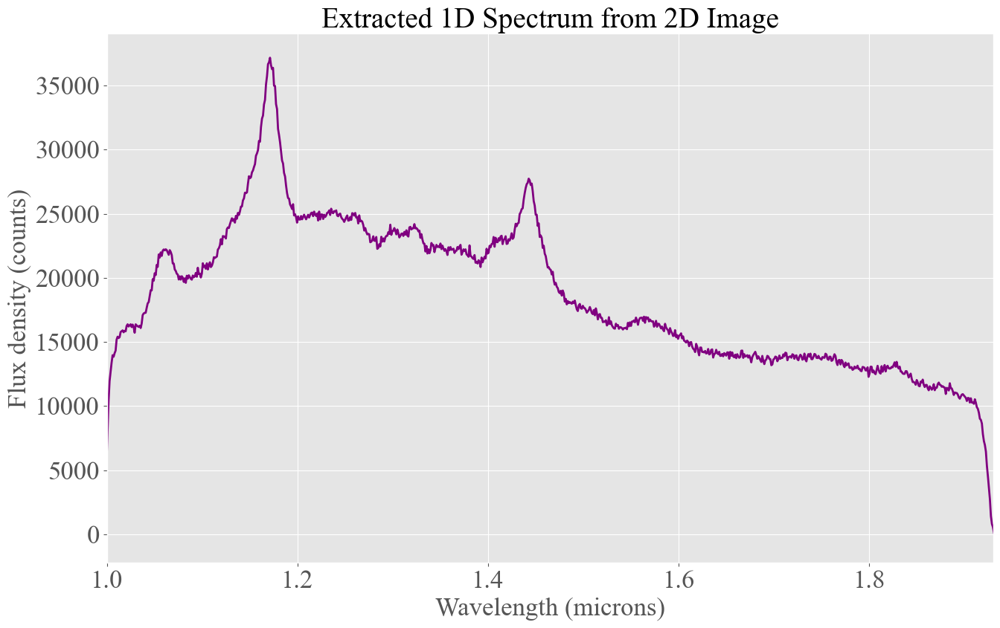

In [13]:

# --- Wavelength grid (consistent and used everywhere below) ---
lambda_grid = wave_start + np.arange(ny) * dispersion_micron
# Step 4: Set global plot style
plt.style.use('ggplot')
plt.rcParams.update({
    'font.size': 25,           # Default text size
    'axes.titlesize': 28,      # Plot title size
    'axes.labelsize': 26,      # Axis label size
    'xtick.labelsize': 25,     # X tick size
    'ytick.labelsize': 25,     # Y tick size
    'legend.fontsize': 25,     # Legend font
    'figure.titlesize': 28     # Figure title
})

# Step 5: Plot spectrum
plt.figure(figsize=(14, 9))
plt.plot(lambda_grid, spectrum_1d, linewidth=2, color='purple')
plt.xlabel("Wavelength (microns)", fontsize=25)
plt.ylabel("Flux density (counts)", fontsize=25)
plt.title("Extracted 1D Spectrum from 2D Image", fontsize=28)
plt.grid(True)
plt.xlim(1, 1.93)  # Limit to expected grism coverage
plt.tight_layout()
plt.show()


## Variance Estimation for Optimal Extraction

For optimal extraction (Horne 1986), a pixel-by-pixel variance estimate is required to compute weights.  
Pixels with lower noise are given more weight, while noisier pixels are down-weighted.

---

**Constants**

- `GAIN_E_PER_CNT`: converts counts (ADU) to electrons.  
  If the data are already in electrons, set this to 1.0.  
- `READ_NOISE`: detector read noise in e^- RMS per pixel.  
- `MIN_VAR`: small variance floor to prevent division by zero.

---

**Step 1. Background contribution**

$bg_e = \mathrm{median\_background} \times \mathrm{GAIN}$

Average background level per pixel, expressed in electrons.

---

**Step 2. Signal contribution**

$sig_e = \max(data, 0) \times \mathrm{GAIN}$

Pixel values converted to electrons, with negatives clipped to zero.

---

**Step 3. Total variance per pixel**

$var = (bg_e + sig_e) + \mathrm{READ\_NOISE}^2$

- First term: Poisson noise from signal and background.  
- Second term: variance from detector read noise.  

---

**Step 4. Apply variance floor**

$var = \max(var, \mathrm{MIN\_VAR})$

Prevents zero variance values and avoids infinite weights.

---

The resulting `var` array is the variance model used in optimal extraction weighting:

$F_{\mathrm{opt}}(y) =
\frac{\sum_x P(y,x)\, d(y,x) / var(y,x)}
     {\sum_x P(y,x)^2 / var(y,x)}$

where $P(y,x)$ is the normalized spatial profile and $d(y,x)$ is the observed data.


### 1D Spectrum Extraction

- Step 1: Dimensions  
  The cropped 2D trace (`data`) has shape (ny, nx).  
  Here ny = dispersion axis (wavelength direction), nx = spatial axis.  

- Step 2: Collapse to 1D  
  Summing along the spatial axis (`axis=1`) collapses the trace into a 1D spectrum.  
  This integrates flux across the slitless “aperture” in the 2D cutout.  

- Step 3: Wavelength mapping  
  Pixel index is converted to wavelength using:  
  $\lambda = \mathrm{wave\_start} + i \times \mathrm{dispersion\_micron}$ 
  where $i$ is the row index along the dispersion axis.  

- Step 4: Plot styling  
  A consistent `ggplot` style and enlarged fonts are applied for clarity.  

- Step 5: Spectrum plot  
  The extracted 1D spectrum is shown as flux density (counts) vs wavelength (µm).  
  The x-axis is restricted to 1.0–1.93 µm, the grism’s effective coverage.  


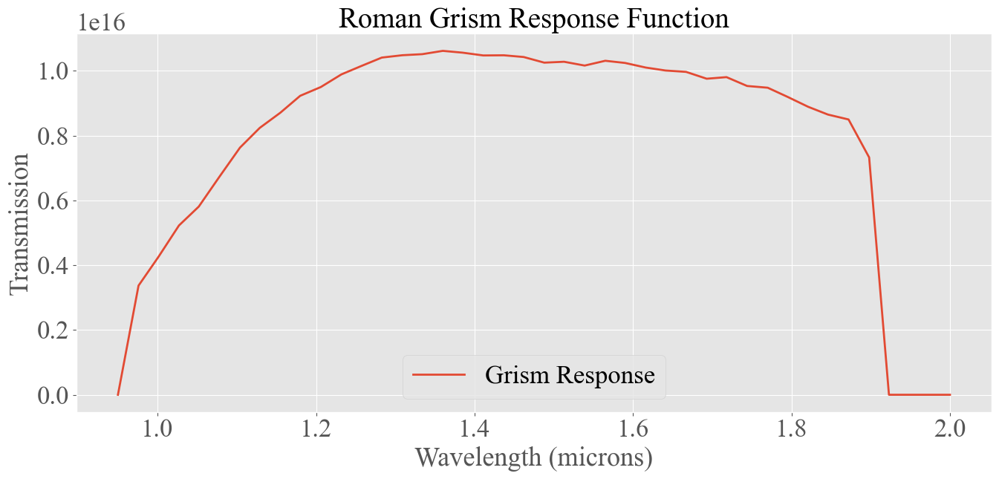

In [19]:
# --- Load grism response and interpolate on lambda_grid ---
response_data = np.loadtxt('//Users/msingha/Downloads/Grism extraction/grism_response_function.txt')
w0 = response_data[:, 0]   # microns
tr0 = response_data[:, 1]  # unitless transmission (0–1)

# --- Plots: response and extracted spectrum ---
plt.style.use('ggplot')
plt.rcParams.update({
    'font.size': 25,
    'axes.titlesize': 28,
    'axes.labelsize': 26,
    'xtick.labelsize': 25,
    'ytick.labelsize': 25,
    'legend.fontsize': 25,
    'figure.titlesize': 28,
    'font.family': 'Times New Roman'
})

# Response curve
plt.figure(figsize=(14, 7))
plt.plot(w0, tr0, label="Grism Response", linewidth=2)
plt.xlabel("Wavelength (microns)")
plt.ylabel("Transmission")
plt.title("Roman Grism Response Function")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

## Grism Response Function

To correctly interpret extracted spectra, the instrument’s **throughput (response function)** must be applied.  
This response curve describes how efficiently the grism + optics + detector transmit light at each wavelength.

---

### Step 1. Load the response data
- The response file (`grism_response_function.txt`) contains two columns:  
  - Wavelength in microns ($\mu m$).  
  - Transmission (unitless, between 0 and 1).  
- These values represent the fraction of incoming photons that are detected as a function of wavelength.

---

### Step 2. Define wavelength and transmission arrays
- `w0`: wavelength grid from the file.  
- `tr0`: corresponding transmission values.  

So `tr0[i]` is the fraction of light transmitted at wavelength `w0[i]`.

---

### Step 3. Plot the response curve
- The curve shows **how sensitive the grism is across wavelength**.  
- Typical shape:
  - Low throughput at edges of the bandpass.  
  - Maximum transmission in the central region.  
- Units:
  - X-axis: wavelength in microns.  
  - Y-axis: fractional transmission (0–1).  

---

### Why it matters
- Raw extracted spectra contain instrument effects.  
- To recover the **true flux**, each spectrum must be divided by this response curve (after interpolation to the spectrum’s wavelength grid).  
- Without this correction, spectra will appear artificially suppressed at wavelengths where throughput is low.


In [18]:
y1 = np.interp(lambda_grid, w0, tr0)
y1_safe = np.clip(y1, 1e-6, None)  # avoid division spikes

# --- Convert to physical-ish units to match your plotting scale ---
# counts → (1e-17 erg/s/cm^2/Å): divide by throughput, dispersion(Å/pix), exposure(s)
flux_opt = F_opt / y1_safe * 1e17 / dispersion_angstrom / exposure_time
flux_opt_err = sigma_opt / y1_safe * 1e17 / dispersion_angstrom / exposure_time


## Calibrating the Extracted Spectrum

The optimally extracted counts must be converted into approximate **physical flux units**.  
This requires correcting for the instrument response, pixel dispersion, and exposure time.

---

### Step 1. Interpolate the response curve
$y_1 = \mathrm{interp}(\lambda_{\mathrm{grid}}, w_0, tr_0)$  

- The grism response function $(w_0, tr_0)$ is defined on its own wavelength grid.  
- Interpolate onto the spectrum’s wavelength grid `lambda_grid` so that each pixel has a matching throughput value.  

A safety clip is applied:  

$y_{1,\mathrm{safe}} = \max(y_1, 10^{-6})$  

This prevents division by very small numbers at band edges (avoiding spikes in flux).

---

### Step 2. Correct for throughput
Raw flux from optimal extraction is in **counts**.  
Divide by throughput to correct for detector/instrument efficiency:

$\; F_{\mathrm{corr}} = \frac{F_{\mathrm{opt}}}{y_{1,\mathrm{safe}}}$

---

### Step 3. Normalize to flux units
Convert from counts to something comparable to astrophysical flux density:  

$\mathrm{flux\_opt} =
\frac{F_{\mathrm{opt}}}{y_{1,\mathrm{safe}} \;\; \Delta\lambda \;\; t_{\mathrm{exp}}}
\times 10^{17}$

where:  
- $\Delta\lambda$ = dispersion in Å/pixel  
- $t_{\mathrm{exp}}$ = exposure time in seconds  
- $10^{17}$ = scale factor so units are approximately in $10^{-17}\,\mathrm{erg\,s^{-1}\,cm^{-2}\,\AA^{-1}}$

---

### Step 4. Propagate uncertainties
Uncertainties from optimal extraction $\sigma_{\mathrm{opt}}$ are scaled the same way:

$\mathrm{flux\_opt\_err} =
\frac{\sigma_{\mathrm{opt}}}{y_{1,\mathrm{safe}} \;\; \Delta\lambda \;\; t_{\mathrm{exp}}}
\times 10^{17}$

---

### Summary
- **Interpolation** ensures the response curve matches the spectral wavelength grid.  
- **Division by throughput** corrects for detector/instrument efficiency.  
- **Dispersion + exposure normalization** converts pixel counts into approximate physical flux density.  
- **Uncertainty propagation** guarantees errors remain in the same units as the flux.


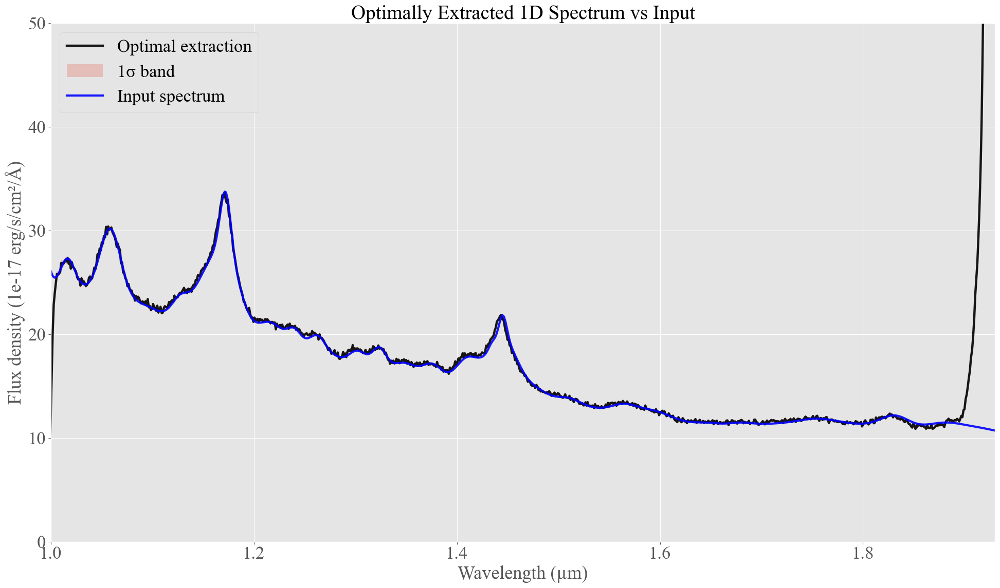

In [20]:
# =============================
# Input vs output Spectrum Visualization
# =============================

# Step 1: Load input spectrum from HDF5
# --- Load input spectrum for comparison ---
with h5py.File('/Users/msingha/Downloads/Grism extraction/QSO_sed_input.hdf5', 'r') as f:
    sed = f['SED/1'][:]  # (N,2)
wavelength = sed[:, 0]  # microns
flux = sed[:, 1]        # 1e-17 erg/s/cm^2/Å


# Step 2: Set global plot style
plt.style.use('ggplot')
plt.rcParams.update({
    'font.size': 25,
    'axes.titlesize': 28,
    'axes.labelsize': 26,
    'xtick.labelsize': 25,
    'ytick.labelsize': 25,
    'legend.fontsize': 25,
    'figure.titlesize': 28
})

# Extracted vs Input
plt.figure(figsize=(20, 12))
plt.plot(lambda_grid, flux_opt, linestyle='-', color='k', lw=3.2, alpha=0.9, label='Optimal extraction')
plt.fill_between(lambda_grid, flux_opt - flux_opt_err, flux_opt + flux_opt_err, alpha=0.25, label='1σ band')
plt.plot(wavelength, flux, linewidth=3.0, color='b', alpha=0.9, label='Input spectrum')
plt.xlabel('Wavelength (µm)')
plt.ylabel('Flux density (1e-17 erg/s/cm²/Å)')
plt.title('Optimally Extracted 1D Spectrum vs Input')
plt.grid(True)
plt.legend(loc='upper left')
plt.xlim(1.0, 1.93)
plt.ylim(0,50)
plt.tight_layout()
plt.show()


## Input Spectrum Visualization (Extracted vs. Ground Truth)

This cell compares the **optimally extracted** 1D spectrum against the **input SED** used to generate the simulation, and visualizes $1\sigma$ uncertainties.

---

### Step 1. Load the input SED from HDF5

- The file contains a dataset at `SED/1` with two columns:
  - `wavelength` in microns
  - `flux` in units of $10^{-17}\,\mathrm{erg\,s^{-1}\,cm^{-2}\,\AA^{-1}}$

These units match the calibrated `flux_opt` produced earlier, enabling a direct comparison.

---

### Step 2. Plot styling

- A larger font and figure size are set for publication-quality readability.
- The style choice does not affect data; it only controls aesthetics.

---

### Step 3. Overlay extracted spectrum, uncertainty band, and input SED

- **Extracted spectrum**: $(\lambda_{\mathrm{grid}}, \mathrm{flux\_opt})$
- **Uncertainty band**: shaded region from $\mathrm{flux\_opt} \pm \mathrm{flux\_opt\_err}$ visualizes the $1\sigma$ error at each pixel.
- **Input SED**: $(\mathrm{wavelength}, \mathrm{flux})$ from the HDF5 file (the ground truth used to simulate the observation).

Axes:
- X-axis: wavelength in microns ($\mu\mathrm{m}$).
- Y-axis: flux density in $10^{-17}\,\mathrm{erg\,s^{-1}\,cm^{-2}\,\AA^{-1}}$.

Limits:
- $\lambda \in [1.0, 1.93]\,\mu\mathrm{m}$ (typical Roman/WFI grism band).
- Flux display range $[0, 50]$ in the chosen units for clarity.

---

### Interpreting the comparison

- The **input SED** represents the target “truth.”  
- The **extracted spectrum** should track the same features after throughput correction and unit normalization.
- Discrepancies can arise from:
  - Residual throughput or flat-field errors,
  - Mismatch in **sampling** or **resolution** between the input SED and $\lambda_{\mathrm{grid}}$,
  - Noise (shot + background + read), extraction weights, or masking.

---

### Practical notes

1. **Grid alignment**: If the input SED grid does not align with $\lambda_{\mathrm{grid}}$, interpolate one to the other before ratio/chi-square comparisons:
   - e.g., $\mathrm{flux}_{\mathrm{in}}(\lambda_{\mathrm{grid}}) = \mathrm{interp}(\lambda_{\mathrm{grid}}, \mathrm{wavelength}, \mathrm{flux})$.
2. **Resolution matching**: If the input SED is higher resolution, convolve it with the instrument LSF before comparison, or equivalently smooth/rebin the extracted spectrum to the SED’s resolution.
3. **Clipping negatives**: For visual clarity you may clip negative flux or plot symmetric error bars even if $\mathrm{flux\_opt} - \mathrm{flux\_opt\_err} < 0$; do not clip for quantitative analysis.
4. **Uncertainty band**: The shaded $1\sigma$ region reflects propagated extraction variance; it does **not** include additional systematics (e.g., calibration, flat-field, wavelength solution).

---

### Outcome

This visualization is a quick sanity check that:
- Throughput correction and unit conversion were applied consistently,
- Spectral features (lines/continuum shape) are recovered within uncertainties,
- The extraction is behaving as expected across the full bandpass.
